# This code is used to visualize and pre-process electrophysiological data stored in .rhs files from an intan. 

## The code to load the .rhs files comes from this GitHub repository: https://github.com/Intan-Technologies/load-rhs-notebook-python/blob/main/importrhsutilities.py
Note you you'll need to download the import the importrhsutilities.py and LoadIntanRHS_Python.ipynb codes from this repository

## Code from Intan to load the .rhs file (you'll need to update the filename):


Reading Intan Technologies RHS Data File, Version 3.0

Found 16 amplifier channels.
Found 0 board ADC channels.
Found 1 board DAC channel.
Found 0 board digital input channels.
Found 0 board digital output channels.

File contains 60.002 seconds of data.  Amplifiers were sampled at 30.00 kS/s.

Allocating memory for data...
Reading data from file...
10% done...
20% done...
30% done...
40% done...
50% done...
60% done...
70% done...
80% done...
90% done...
Parsing data...
No missing timestamps in data.
Done!  Elapsed time: 3.1 seconds
D-000
D-001
D-002
D-003
D-004
D-005
D-006
D-007
D-008
D-009
D-010
D-011
D-012
D-013
D-014
D-015
ANALOG-OUT-1


<Figure size 640x480 with 0 Axes>

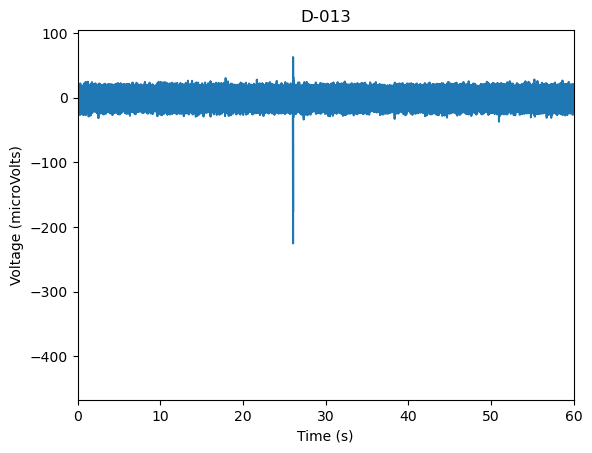

In [5]:
# Load the background Python functions that allow for data loading and plotting
%run importrhsutilities.py

filename = '/Users/mirandahulsey-vincent/Documents/allPythonCode/BYOD_class/data_inputs/ZFG5__241211_142135.rhs' # Change this variable to load a different data file
result, data_present = load_file(filename)

print_all_channel_names(result) # Uncomment this line and re-run cell to display names of all available channels

channel_name = 'D-013' # Change this variable and re-run cell to plot a different channel

%matplotlib inline

if data_present:
    plot_channel(channel_name, result)
    
else:
    print('Plotting not possible; no data in this file')

## Adjust the code to make a plotly graph that can zoom in and out

In [3]:
import plotly.graph_objects as go

def plotly_channel (channel_name, result):
    """Plots all data associated with channel specified as 'channel_name' in
    'result' dict using Plotly for interactive visualization.
    """
    # Find channel that corresponds to this name
    channel_found, signal_type, signal_index = find_channel_in_header(
        channel_name, result)

    # Plot this channel
    if channel_found:
        if signal_type == 'amplifier_channels':
            ylabel = 'Voltage (microVolts)'
            signal_data_name = 'amplifier_data'

        elif signal_type == 'dc_amplifier_channels':
            ylabel = 'Voltage (Volts)'
            signal_data_name = 'dc_amplifier_data'

        elif signal_type == 'stim_channels':
            ylabel = 'Current (microAmps)'
            signal_data_name = 'stim_data'

        elif signal_type == 'amp_settle_channels':
            ylabel = 'Amp Settle Events (High or Low)'
            signal_data_name = 'amp_settle_data'

        elif signal_type == 'charge_recovery_channels':
            ylabel = 'Charge Recovery Events (High or Low)'
            signal_data_name = 'charge_recovery_data'

        elif signal_type == 'compliance_limit_channels':
            ylabel = 'Compliance Limit Events (High or Low)'
            signal_data_name = 'compliance_limit_data'

        elif signal_type == 'board_adc_channels':
            ylabel = 'Voltage (Volts)'
            signal_data_name = 'board_adc_data'

        elif signal_type == 'board_dac_channels':
            ylabel = 'Voltage (Volts)'
            signal_data_name = 'board_dac_data'

        elif signal_type == 'board_dig_in_channels':
            ylabel = 'Digital In Events (High or Low)'
            signal_data_name = 'board_dig_in_data'

        elif signal_type == 'board_dig_out_channels':
            ylabel = 'Digital Out Events (High or Low)'
            signal_data_name = 'board_dig_out_data'

        else:
            raise ChannelNotFoundError(
                'Plotting failed; signal type ', signal_type, ' not found')

        # Create Plotly figure
        fig = go.Figure()

        # Add trace to the figure
        fig.add_trace(go.Scatter(
            x=result['t'], 
            y=result[signal_data_name][signal_index, :],
            mode='lines',
            name=channel_name
        ))

        # Set titles and labels
        fig.update_layout(
            title=dict(
            text=f"Signal from channel {channel_name}",
            x=0.5,  # Centers the title
            xanchor='center',
            ),
            xaxis_title='Time (s)',
            yaxis_title=ylabel,
            margin=dict(l=20, r=20, t=40, b=20),
            hovermode='closest'
        )

        # Display the figure
        fig.show()

    else:
        raise ChannelNotFoundError(
            'Plotting failed; channel ', channel_name, ' not found')


In [6]:
# Dummy function to simulate channel lookup
def find_channel_in_header(channel_name, result):
    for i, ch in enumerate(result['amplifier_channels']):
        if ch['native_channel_name'] == channel_name:
            return True, 'amplifier_channels', i
    return False, None, None

# Define custom error
class ChannelNotFoundError(Exception):
    pass

# Now call the plotting function with a real channel name
plotly_channel('D-013', result)